# DeepONet(Deep Operator Network)


## 학습 목표
: PhysicsNeMo-Sym을 이용하여 DeepONet 코드 구현 및 이해.

## 핵심 포인트
1. DeepONet을 학습에 대한 세팅을 할 때 config에서 어떠한 값을 바꿀 수 있는가?
2. DeepONet의 구조를 어떻게 선언하는가?
3. DeepONet의 input (자세하게, Branch Net 및 Trunk Net의 input)은 문제에 따라 어떤 모양으로 들어가는가?
4. 학습을 한 후 evaluation을 어떻게 하는가?


# 환경 구축


## Run Time check & Version sanity checks

In [1]:
import sys, subprocess, platform, os, re

print("Python  :", sys.version.replace("\n"," "))
print("Platform:", platform.platform())

# PyTorch/CUDA quick check (optional)
try:
    import torch
    print("Torch   :", torch.__version__)
    print("CUDA?   :", torch.cuda.is_available())
except Exception as e:
    print("Torch not installed yet.", e)

Python  : 3.12.12 (main, Oct 10 2025, 08:52:57) [GCC 11.4.0]
Platform: Linux-6.6.105+-x86_64-with-glibc2.35
Torch   : 2.8.0+cu126
CUDA?   : True


## Install PhysicsNemo-sym
- 에러 창이 뜨더라도 "취소"를 누르고 다음 셀을 진행.

In [2]:
!pip -q install "fsspec==2025.3.0" "s3fs==2025.3.0" "gcsfs==2025.3.0" "jedi>=0.16"
!pip -q install -U hydra-core==1.3.2 omegaconf==2.3.0 mlflow

# PhysicsNemo(sym): 중복 설치/의존성 충돌 방지
!pip -q install nvidia-physicsnemo-sym --no-build-isolation
!pip -q install --no-deps "nvidia-physicsnemo-sym==2.2.0"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 51.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 144.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.0/88.0 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.0/40.0 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.9/8.9 MB 122.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 111.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 90.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.8/147.8 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.9/114.9 kB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.8/76.8

## Git clone & set paths


- Darcy Flow, Anti-derivative(Data Driven, Physics-informed)에 대해 데이터, 학습 파라미터를 담은 파일을 다운로드.
- 학습에 필요한 package('utilities')를 설치



In [7]:
REPO = "/content/PhysicsNemo_DeepONet"

import os, sys, importlib, shutil
if not os.path.exists(REPO):
    !git clone -q https://github.com/jasonok467570/PhysicsNemo_DeepONet.git

# PhysicsNemo-sym에 설치되지 않은 함수를 설치하는 과정
%cd $REPO
sys.path.insert(0, REPO)              #
from Darcy_DeepONet import utilities
importlib.reload(utilities)
print("utilities imported OK")

/content/PhysicsNemo_DeepONet
utilities imported OK


# Darcy Flow

## Problem Description — Darcy PDE Surrogate

### 목표
정상상태 Darcy PDE
$$
-\nabla\!\cdot\!\big(k(\mathbf{x})\,\nabla p(\mathbf{x})\big)=f(\mathbf{x})
\quad \text{in } \Omega=[0,1]^2,\qquad
p|_{\partial\Omega}=0
$$
에서 **연산자** $$(\mathcal{G}: k(\cdot)\mapsto p(\cdot))$$ 를 **데이터 기반**으로 학습.



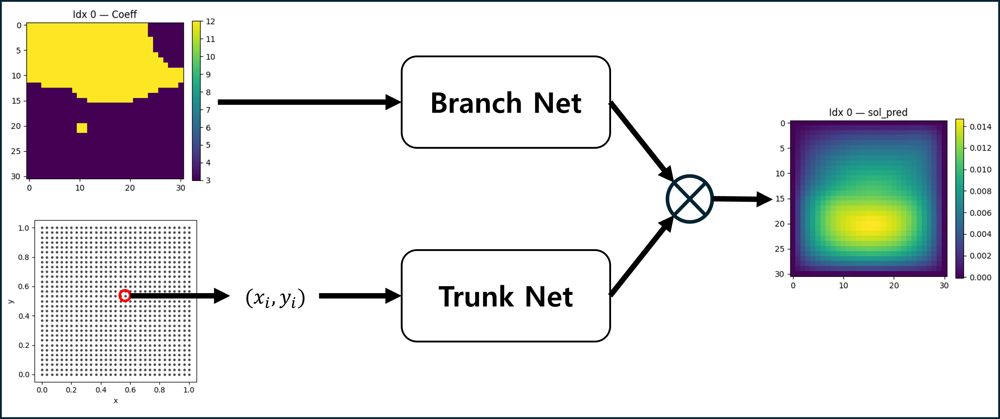

## 1. Load Hydra config safely
- 해당 부분은 .py 파일이 아닌 .ipynb 파일로 만들때 하는 것이다. PhysicsNemo에 py 파일을 사용할 때는 필요가 없다.
- 원래 코드에서 해당 부분은 다음과 같이 작성되어있다.

```
@physicsnemo.sym.main(config_path="conf", config_name="config_DeepO")
def run(cfg:PhysicsNeMoConfig)-> None:
   (코드들...)

if __name__=="__main__":
   run()
```

** ``` __name__=="__main__"```은 해당 py 파일을 직접 실행할 때만 특정 코드를 실행. 다른 파일에서 import 할 때는 실행하지 않도록하는 장치




In [8]:
from pathlib import Path
import sys
from hydra import compose, initialize_config_dir
from hydra.core.global_hydra import GlobalHydra
from omegaconf import OmegaConf
import physicsnemo.sym

sys.argv = [sys.argv[0]]
CONF_DIR_Darcy = Path(REPO) / "Darcy_DeepONet" / "conf"
CONF_NAME_Darcy = "config_DeepO.yaml"
@physicsnemo.sym.main(
    config_path=str(CONF_DIR_Darcy),
    config_name="config_DeepO",
)
def _preview_config(cfg) -> None:
    print("=== Config successfully loaded ===")
    try:
        print(OmegaConf.to_yaml(cfg))
    except Exception:
        print(cfg)
try:
    _preview_config()
except SystemExit:
    pass
if GlobalHydra.instance().is_initialized():
    GlobalHydra.instance().clear()

initialize_config_dir(config_dir=str(CONF_DIR_Darcy))
cfg_Darcy = compose(config_name="config_DeepO")

[07:51:52] - JIT using the NVFuser TorchScript backend
[07:51:52] - JitManager: {'_enabled': True, '_arch_mode': <JitArchMode.ONLY_ACTIVATION: 1>, '_use_nvfuser': True, '_autograd_nodes': False}
[07:51:52] - GraphManager: {'_func_arch': False, '_debug': False, '_func_arch_allow_partial_hessian': True}
[07:51:52] - AmpManager: {'_enabled': False, '_mode': <AmpMode.PER_ORDER_SCALER: 0>, '_dtype': torch.float16, '_default_max_scale': 1, '_autocast_activation': False, '_autocast_firstlayer': False, '_special_terms': [], '_custom_max_scales': {}}
=== Config successfully loaded ===
training:
  max_steps: 100000
  grad_agg_freq: 1
  rec_results_freq: 1000
  rec_validation_freq: 1000
  rec_inference_freq: ${training.rec_results_freq}
  rec_monitor_freq: ${training.rec_results_freq}
  rec_constraint_freq: ${training.rec_results_freq}
  save_network_freq: 1000
  print_stats_freq: 100
  summary_freq: 1000
  grad_clip_max_norm: 0.5
  monitor_grad_clip: true
  ntk:
    use_ntk: false
    save_name:

/usr/local/lib/python3.12/dist-packages/hydra/_internal/hydra.py:119: UserWarning: Future Hydra versions will no longer change working directory at job runtime by default.
See https://hydra.cc/docs/1.2/upgrades/1.1_to_1.2/changes_to_job_working_dir/ for more information.
  ret = run_job(
/tmp/ipython-input-1733448547.py:28: UserWarning: 
The version_base parameter is not specified.
Please specify a compatability version level, or None.
Will assume defaults for version 1.1
  initialize_config_dir(config_dir=str(CONF_DIR_Darcy))


### 불러온 config 파일의 내용의 일부를 확인하는 코드
- config 파일의 내용을 수정하고 싶으면 다음과 같은 방법으로 수정하면 된다 : ```cfg['training']['summary_freq'] = 100 ```

### Config 파일에서의 의미 및 바꿀 수 있는 값

- Top-level
  - `network_dir` : checkpoint와 log(TensorBoard)가 저장/ 복원되는 루트 경로. 학습 재개/ 평가 시 반드시 기존 checkpoint 폴더를 가리켜야함.
  - `initialization_network_dir` : 초기 가중치를 불러올 초기화 전용 경로. 없으면 랜덤 초기화.
  - `run_mode` : `train` , `eval` 에 따라 학습 할 지 평가 할 지 정함.

- Training
  - `max_steps` : 총 step 수, 도달 시 학습 종료
  - `grad_agg_freq` : mini batch loss를 여러 번 누적하여 한 번의 optimize step으로 적용
  - `rec_results_freq, rec_validation_freq, rec_inference_freq, rec_monitor_freq, rec_constraint_freq` : 각 결과(검증/추론/모니터/snapshot) 저장/ logging 주기.
  - `save_network_freq` : checkpoint 저장 주기 (모델 weight parameter, optimal/scheduler)
  - `print_stats_freq` : log 출력 주기
  -`summary_freq` : TensorBoard 기록 주기
  -`grad_clip_max_norm, monitor_grad_clip` : 전체 parameter gradient L2 norm clipping 임계치 및 모니터링 활성화.
  - `ntk.(...)` : NTK 모니터링 사용.

- arch (모델 정의)
  DeepONet은 Branch net, Trunk net, 그리고 이 둘을 합친 DeepONet이 필요.
  - `arch_type` : Network 구조 (ex. pix2pix, fully_connected, fourier_net, siren, ...)
    - DeepONet에 대해서는 반드시 `arch_type : "deeponet"`으로 해야함
  - `input_keys, output_keys` : 입력 / 출력 변수 목록
  - Network에 대한 Hyperparameter(수정 가능한 값들)
    - pix2pix : `dimension, conv_layer_size, n_downsampling, n_blocks, batch_norm, padding_type, activation_fn`
    - fourier_net : `frequencies, frequencies_params, layer_size, nr_layers, activation_fn, skip_connections, weight_norm, adaptive_activations`

- Loss (loss function 계산 정의)
  기본으로 `sum`으로 가중합을 이용
  - 이외에 `grad_norm`(Gradient Normalization for adaptive loss balancing),  `lr_annealing` (Learning Rate Annealing), `soft_adapt`(Adaptive Loss weighting), `relobralo`(Relative loss balancing with random lookback) 존재

- Optimizer
  기본으로 'adam'으로 사용
  - 이외에 `sgd`(Standard stochastic gradient descent), `rmsprop`(RMSProp), `adahessian`(Second order stochastic optimization algorithm), `bfgs`(L-BFGS iterative optimization method) 존재

- Scheduler
  - `exponential_lr` : Pytorch exponential learning rate decay :  $\text{(initial_learning_rate)} * \text{(gamma)} ^ \text{(step)}$
  - `tf_exponential_lr` : Tensorflow parameterization of exponential learning rate : $\text{(initial_learning_rate)} * \text{(decay_rate)} ^ \text{(step/ decay_steps)}$

- batch_size : Mini batch의 크기.

---
** 자세한 내용은 아래의 docs에서 확인 가능

https://docs.nvidia.com/physicsnemo/latest/physicsnemo-sym/user_guide/features/configuration.html

In [9]:
from pprint import pprint

def to_dict(cfg):
    return OmegaConf.to_container(cfg, resolve=True)

def pluck(d, *keys, default=None):
    cur = d
    for k in keys:
        if isinstance(cur, dict) and k in cur:
            cur = cur[k]
        else:
            return default
    return cur

def summarize_cfg(cfg):
    d = to_dict(cfg)
    return {
        "training": {
            "max_steps": pluck(d, "training", "max_steps"),
            "ntk"      : pluck(d, "training", "ntk"),
        },
        "branch": {
            "arch_type"    : pluck(d, "arch", "branch", "arch_type"),
            "input_keys"   : pluck(d, "arch", "branch", "input_keys"),
            "output_keys"  : pluck(d, "arch", "branch", "output_keys"),
            "activation_fn": pluck(d, "arch", "branch", "activation_fn"),
        },
        "trunk": {
            "arch_type"    : pluck(d, "arch", "trunk", "arch_type"),
            "input_keys"   : pluck(d, "arch", "trunk", "input_keys"),
            "output_keys"  : pluck(d, "arch", "trunk", "output_keys"),
            "activation_fn": pluck(d, "arch", "trunk", "activation_fn"),
        },
        "deeponet": {
            "arch_type"   : pluck(d, "arch", "deeponet", "arch_type"),
            "output_keys" : pluck(d, "arch", "deeponet", "output_keys"),
        },
        "loss": {
            "_target_" : pluck(d, "loss", "_target_"),
            "weights"  : pluck(d, "loss", "weights"),
        },
        "optimizer": {
            "_target_"    : pluck(d, "optimizer", "_target_"),
            "lr"          : pluck(d, "optimizer", "lr"),
            "betas"       : pluck(d, "optimizer", "betas"),
            "eps"         : pluck(d, "optimizer", "eps"),
            "weight_decay": pluck(d, "optimizer", "weight_decay"),
            "amsgrad"     : pluck(d, "optimizer", "amsgrad"),
        },
        "batch_size": {
            "train": pluck(d, "batch_size", "train"),
        },
    }

summary = summarize_cfg(cfg_Darcy)
pprint(summary, width=100, sort_dicts=False)
# config 내용을 수정하고 싶으면 아래와 같이 수정하면 된다.
# cfg['training']['max_steps'] = 100000
# cfg['training']['rec_validation_freq']=100
# cfg['training']['rec_inference_freq'] = 100
# cfg['training']['rec_monitor_freq'] = 100
# cfg['training']['rec_constraint_freq'] = 100
# cfg['training']['save_network_freq'] = 100
# cfg['training']['print_stats_freq'] = 100
# cfg['training']['summary_freq'] = 100

# 출력/체크포인트 디렉토리 지정(없으면 생성)
from pathlib import Path
cfg_Darcy.network_dir = f"{REPO}/Darcy_DeepONet/outputs"
Path(cfg_Darcy.network_dir).mkdir(parents=True, exist_ok=True)


{'training': {'max_steps': 100000, 'ntk': {'use_ntk': False, 'save_name': None, 'run_freq': 1000}},
 'branch': {'arch_type': 'pix2pix',
            'input_keys': ['coeff'],
            'output_keys': ['branch'],
            'activation_fn': 'relu'},
 'trunk': {'arch_type': 'fourier',
           'input_keys': ['x', 'y'],
           'output_keys': ['trunk', 256],
           'activation_fn': 'silu'},
 'deeponet': {'arch_type': 'deeponet', 'output_keys': 'sol'},
 'loss': {'_target_': 'physicsnemo.sym.loss.aggregator.Sum', 'weights': None},
 'optimizer': {'_target_': 'torch.optim.Adam',
               'lr': 0.001,
               'betas': [0.9, 0.999],
               'eps': 1e-08,
               'weight_decay': 0.0,
               'amsgrad': False},
 'batch_size': {'train': 1000}}


## 2. Load Datasets (train / test(valid))

### 데이터 구성
- **입력 $k(\mathbf{x})$**: 2D 격자 $(H\times W)$로 샘플 생성
- **타깃 $p(\mathbf{x})$**: 수치해석(FEM/FDM)으로 PDE를 풀어 생성.


In [16]:
from physicsnemo.sym.key import Key
from Darcy_DeepONet.utilities import load_deeponet_dataset

train_path_Darcy = f"{REPO}/Darcy_DeepONet/data/piececonst_r61_N1024_smooth1.hdf5"
test_path_Darcy  = f"{REPO}/Darcy_DeepONet/data/piececonst_r61_N1024_smooth2.hdf5"

n_examples_train = 1000
n_examples_test  = 10
filter_size      = 2   # 61x61 -> 31x31 (메모리 부담 시 3/4)

branch_input_keys = [Key("coeff")]
output_keys       = [Key("sol")]

invar_train, outvar_train = load_deeponet_dataset(
    train_path_Darcy,
    [k.name for k in branch_input_keys],
    [k.name for k in output_keys],
    n_examples=n_examples_train,
    filter_size=filter_size
)
invar_test, outvar_test = load_deeponet_dataset(
    test_path_Darcy,
    [k.name for k in branch_input_keys],
    [k.name for k in output_keys],
    n_examples=n_examples_test,
    filter_size=filter_size
)
print("Loaded shapes:",
      {k:v.shape for k,v in invar_train.items()},
      {k:v.shape for k,v in outvar_train.items()})

loaded: /content/PhysicsNemo_DeepONet/Darcy_DeepONet/data/piececonst_r61_N1024_smooth1.hdf5
avaliable keys: ['coeff', 'sol']
selected key: coeff, mean: 7.48309e+00, std: 4.49997e+00
selected key: sol, mean: 5.60443e-03, std: 3.93984e-03
loaded: /content/PhysicsNemo_DeepONet/Darcy_DeepONet/data/piececonst_r61_N1024_smooth2.hdf5
avaliable keys: ['coeff', 'sol']
selected key: coeff, mean: 7.67390e+00, std: 4.49664e+00
selected key: sol, mean: 5.50131e-03, std: 3.87071e-03
Loaded shapes: {'coeff': (961000, 1, 31, 31), 'x': (961000, 1), 'y': (961000, 1)} {'sol': (961000, 1)}


### ```load_deeponet_dataset```에 대한 세부 설명

#### Input
*   path : ```.hdf5``` 데이터 경로
*   input_keys : 입력 field 이름 list (ex. "coeff")
*   output_keys : 출력 field 이름 list (ex. "sol")
*   n_examples : 사용할 sample의 개수
*   filter_size : Grid에 대해 down sampling 간격 (격자의 해상도 낮추기)
(현재 데이터 사이즈가 $61 \times 61$인데, 이후 Branch net에서 pic2pic 이라는 network를 사용해서 filter_size=8로 하면 안된다.)


#### return
* tiled_invar : 입력(Branch, Trunk net)을 DeepONet 학습 형식으로 학장한 dict
* tiled_outvar : 출력 필드를 flat하게 (shape = (Num,1)) 로 만든 dict


In [23]:
# ex.  Invar_train, outvar_train에 대한 예시
from physicsnemo.sym.hydra import to_absolute_path
import h5py
# input
path_ = train_path_Darcy
input_keys_ = [k.name for k in branch_input_keys]
output_keys_ = [k.name for k in output_keys]
n_examples=n_examples_train
filter_size=filter_size
# 주어진 경로를 실행 디렉터리 기준의 절대경로로 변환
path__ = to_absolute_path(path_)

# HDF5 파일을 읽기 모드("r")로 연다
# 주의: h5py.File(...)는 사용 후 del 또는 close 필요
data = h5py.File(path__, "r")

# 파일 안의 최상위 데이터셋/그룹 이름을 수집(내부 메타키 "__"로 시작하는 항목은 제외)
_ks = [k for k in data.keys() if not k.startswith("__")]
print(f"loaded: {path__}\navaliable keys: {_ks}")

# 입력/출력 딕셔너리 준비
invar, outvar = dict(), dict()

# 입력 키들과 출력 키들을 같은 로직으로 순회하며 파싱
test_ = 0
for d, keys in [(invar, input_keys_), (outvar, output_keys_)]:
  if test_ == 0:
    for k in keys:
        # (실제 데이터셋 핸들을 가져옴 (형상: (N, C, H, W))
        x = data[k]  # N, C, H, W
        print("실제 데이터 셋의 shape :", x.shape)

        # n_examples가 지정된 경우 앞에서부터 N 축으로 잘라 일부만 사용
        if n_examples is not None:
            x = x[:n_examples]
            print(f"{n_examples}개의 데이터 셋의 shape :", x.shape)

        # 선택된 데이터의 평균/표준편차를 출력(현재 코드에서는 정규화 안해서 불필요)
        print(f"selected key: {k}, mean: {x.mean():.5e}, std: {x.std():.5e}")

        # 파싱된 배열(또는 h5py 슬라이스)을 해당 딕셔너리에 저장
        d[k] = x

# 파일 핸들 제거(닫기). 권장: with h5py.File(...) as f: 구문 사용
del data


loaded: /content/PhysicsNemo_DeepONet/Darcy_DeepONet/data/piececonst_r61_N1024_smooth1.hdf5
avaliable keys: ['coeff', 'sol']
실제 데이터 셋의 shape : (1024, 1, 61, 61)
1000개의 데이터 셋의 shape : (1000, 1, 61, 61)
selected key: coeff, mean: 7.48309e+00, std: 4.49997e+00
실제 데이터 셋의 shape : (1024, 1, 61, 61)
1000개의 데이터 셋의 shape : (1000, 1, 61, 61)
selected key: sol, mean: 5.60443e-03, std: 3.93984e-03


In [24]:
# DeepONet에 쓰기 전에 해상도 downsampling: filter_size 간격으로 H,W를 줄임
import numpy as np

for key, value in invar.items():
    invar[key] = value[:, :, ::filter_size, ::filter_size]   # → (N, C, H', W')
for key, value in outvar.items():
    outvar[key] = value[:, :, ::filter_size, ::filter_size]  # → (N, C, H', W')

# 한 변의 해상도와, 샘플 1개당 좌표 포인트 수(H'×W') 계산
res = next(iter(invar.values())).shape[-1]   # W' (H'==W' 가정)
nr_points_per_sample = res**2                # = H' * W'

# 입력(invar)을 DeepONet 학습 배치 형태로 '타일링'
#    - 각 샘플 i에 대해, 그 샘플의 장(value[i])을 (H'W', C, H', W')로 복제
#    - 모든 i(=n_examples) 샘플에 대해 concat → (n_examples*H'W', C, H', W')
#    - 하나의 샘플 (value[i].shape = (C, H', W'))를 좌표 포인트 수 H'W' 만큼 복제하여, 배치 축을 만든뒤 각 좌표 (x,y)와 1:1 대응 시킨다.

tiled_invar = {
    key: np.concatenate(
        [
            np.tile(value[i], (nr_points_per_sample, 1, 1, 1))
            for i in range(n_examples)
        ]
    )
    for key, value in invar.items()
}

# 출력(outvar)은 단일 스칼라장으로 가정: 전체를 평탄화 후 열벡터로
#    (N, C, H', W') → (N*C*H'*W', 1)
tiled_outvar = {key: value.flatten()[:, None] for key, value in outvar.items()}

# 6) 좌표 특징 추가: [0,1] 구간에 균등한 H'×W' 격자 → (H'W',1)로 플랫
x = np.linspace(0.0, 1.0, res)
y = np.linspace(0.0, 1.0, res)
x, y = [a.flatten()[:, None] for a in np.meshgrid(x, y)]

# 7) 좌표를 샘플 수만큼 반복하여 입력 dict에 주입
#    (n_examples*H'W', 1)이 되도록 반복해서 concat
tiled_invar["x"] = np.concatenate(n_examples * [x], axis=0)
tiled_invar["y"] = np.concatenate(n_examples * [y], axis=0)

print("coeff의 shape : ", tiled_invar["coeff"].shape)
print("sol의 shape : ", tiled_outvar["sol"].shape)
print("x의 shape : ", tiled_invar["x"].shape)
print("y의 shape : ", tiled_invar["y"].shape)


coeff의 shape :  (961000, 1, 31, 31)
sol의 shape :  (961000, 1)
x의 shape :  (961000, 1)
y의 shape :  (961000, 1)


## 3. Build DeepONet & Domain

### 모델(DeepONet) 개요
- **Branch**: $k(x)$  → 임베딩 $\mathbf{b}\in\mathbb{R}^{d}$
- **Trunk**: $(x,y)$ → 임베딩 $\mathbf{t}(x,y)\in\mathbb{R}^{d}$
- **DeepONet**: $\hat{p}(x,y)=\langle \mathbf{b},\mathbf{t}(x,y)\rangle\$

### Network 정의

#### ```instantiate_arch()```의 역할
* input : config.arch.branch / trunk / deeponet
* output : 초기화된 아키텍쳐 객체(Arch)

#### ```make_node()```의 역할
* Node는 Graph에 올릴 수 있는 연산 노드


In [25]:
from physicsnemo.sym.hydra import instantiate_arch
branch_net_Darcy = instantiate_arch(cfg_Darcy.arch.branch)
trunk_net_Darcy  = instantiate_arch(cfg_Darcy.arch.trunk)
deeponet_Darcy   = instantiate_arch(cfg_Darcy.arch.deeponet, branch_net=branch_net_Darcy, trunk_net=trunk_net_Darcy)
nodes_Darcy = [deeponet_Darcy.make_node(name="deepo")]


In [33]:
from typing import List, Any
import torch

def _pick_arch_holder(node):
    """Node 객체 내부에서 arch(nn.Module)를 담고 있는 필드명을 추론."""
    for attr in ("arch", "model", "module", "op"):
        if hasattr(node, attr):
            obj = getattr(node, attr)
            if isinstance(obj, torch.nn.Module):
                return attr, obj
    # 일부 구현은 node 자체가 nn.Module을 들고 있을 수도 있음
    if isinstance(node, torch.nn.Module):
        return "<node_is_module>", node
    return None, None

def _as_list_names(x):
    try:
        # Key 객체 리스트인 경우 str(Key)가 예쁘게 이름을 돌려줌
        return [str(k) for k in x]
    except Exception:
        return list(x) if hasattr(x, "__iter__") else [str(x)]

def summarize_nodes(nodes: List[Any], detailed: bool = False, max_params: int = 10_000):
    """
    nodes 리스트의 각 Node를 요약 출력.
    - detailed=True 이면 상위 몇 개 파라미터 이름/shape도 보여줌.
    - max_params: 너무 큰 모델은 전체 파라미터 나열을 생략.
    """
    for i, node in enumerate(nodes):
        print("="*80)
        print(f"[{i}] Node object:", type(node).__name__)

        # 이름
        name = getattr(node, "name", None)
        print("  • name:", name)

        # 입력/출력 키
        inputs  = getattr(node, "inputs",  None)
        outputs = getattr(node, "outputs", None)
        if inputs is None or outputs is None:
            # Node가 키를 직접 안 들고 있으면 arch 쪽에서 보충
            _, arch = _pick_arch_holder(node)
            if arch is not None:
                inputs  = inputs  or getattr(arch, "input_keys",  None)
                outputs = outputs or getattr(arch, "output_keys", None)
        print("  • input keys :", _as_list_names(inputs)  if inputs  is not None else None)
        print("  • output keys:", _as_list_names(outputs) if outputs is not None else None)

        # optimize 플래그
        optimize = getattr(node, "optimize", getattr(node, "optimize_", None))
        print("  • optimize:", optimize)

        # 내부 arch(nn.Module)
        holder, arch = _pick_arch_holder(node)
        print("  • arch holder attr:", holder)
        print("  • arch class      :", type(arch).__name__ if arch is not None else None)

        # 체크포인트 파일명
        ckpt = getattr(node, "checkpoint_filename", None)
        if ckpt is None and arch is not None:
            ckpt = getattr(arch, "checkpoint_filename", None)
        print("  • checkpoint file :", ckpt)

        # 파라미터 통계
        if arch is not None:
            params = list(arch.parameters())
            n_params = sum(p.numel() for p in params)
            n_trainable = sum(p.numel() for p in params if p.requires_grad)
            print(f"  • #params total/trainable: {n_params:,} / {n_trainable:,}")

            if detailed and n_params <= max_params:
                print("  • named parameters (head):")
                for j, (n, p) in enumerate(arch.named_parameters()):
                    print(f"      - {n:40s} {tuple(p.shape)}{'  (frozen)' if not p.requires_grad else ''}")
                    if j >= 19:  # 처음 20개만
                        print("      ...")
                        break

        # 기타 유용한 필드
        # (노드가 직접 들고 있을 수도, arch가 들고 있을 수도 있음)
        input_dict  = getattr(node, "input_key_dict",  None) or (getattr(arch, "input_key_dict",  None) if arch else None)
        output_dict = getattr(node, "output_key_dict", None) or (getattr(arch, "output_key_dict", None) if arch else None)
        print("  • input_key_dict :", input_dict)
        print("  • output_key_dict:", output_dict)

    print("="*80)
    print(f"Total nodes: {len(nodes)}")

# 사용 예시:
# summarize_nodes(nodes_Darcy, detailed=True)


In [37]:
summarize_nodes(nodes_Darcy, detailed=True)  # 파라미터 헤드까지

[0] Node object: Node
  • name: Arch Node: deepo
  • input keys : ['coeff', 'x', 'y']
  • output keys: ['sol']
  • optimize: True
  • arch holder attr: None
  • arch class      : None
  • checkpoint file : None
  • input_key_dict : None
  • output_key_dict: None
Total nodes: 1


### 학습 제약
- **Pointwise 지도 손실**:  
  $$
  \mathcal{L}_\text{data}
  =\big\|\hat{p}(x,y)-p(x,y)\big\|_2^2
  $$
- **구성**:  
  `DeepONetConstraint.from_numpy(nodes, invar={"k":K,"x":X,"y":Y}, outvar={"p":P})`

### 검증(Validator)
- **PointwiseValidator**: Test set의 포인트에 대해 $\hat{p}$ 예측 후 상대 $L^2$ 기록.

### ```DeepONetConstraint()``` 역할

- 학습용 포인트 제약 : 준비된 `(invar, outvar)` 데이터셋을 그대로 batch 단위로 꺼내서, `nodes`(= DeepONet 노드 그래프)에 넣고 Predict 값과 Exact 값의 pointwise loss를 계산.

```python
data = DeepONetConstraint.from_numpy(
    nodes=nodes,              # Graph를 구성할 Node들 (보통 DeepONet 1개 노드)
    invar=invar_train,        # dict[str, np.ndarray], 예: {"coeff":(N,1), "x":(N,1), "y":(N,1)}
    outvar=outvar_train,      # dict[str, np.ndarray], 예: {"sol":(N,1)}
    batch_size=1024,            # 미니배치 크기
    lambda_weighting=None,    # (선택) 손실 가중치 dict[str, (N,1)]
    loss=PointwiseLossNorm(), # 기본 L2 계열 pointwise 손실
    shuffle=True, drop_last=True, num_workers=0
)
domain.add_constraint(data, "data")
```

### ```DeepONetConstraint()``` 원리
- `DictPointwiseDataset()`을 만들어 `(invar, outvar, lambda=None)`를 data loader에 올림.
- `Graph(nodes, ...)`로 Node 그래프 구성하고, batch마다 **forward**와 **loss**를 계산 및 학습.


*   forward : `pred = model(invar_batch)`
*   loss : `Loss(pred, outvar_batch, lambda_batch)`

** 자세한 내용은 다음 docs에서 보면 된다.
https://docs.nvidia.com/physicsnemo/latest/physicsnemo-sym/api/physicsnemo.sym.domain.constraint.html#physicsnemo.sym.domain.constraint.continuous.DeepONetConstraint


### `PointwiseValidator()`역할

- 포인트 단위 검증용(Validation) : 준비된 `(invar, true_outvar)`를 mini batch로 읽어 Predicti 값과 Exact 값을 비교하고, 기본 상대 L2 오차를 산출/logging/저장.

```python
val_Darcy = PointwiseValidator(
    nodes=nodes_Darcy,         # Graph를 구성할 Node들 (보통 DeepONet 1개 노드)
    invar=invar_test,          # {"coeff":(N,1), "x":(N,1), "y":(N,1)}
    true_outvar=outvar_test,   # {"sol":(N,1)}
    batch_size=2048,
    plotter=None,              # 또는 ValidatorPlotter(...)
    requires_grad=False        # 검증에 autodifferentiation(자동 미분)이 필요한 경우 True, 그 외엔 False
)
domain.add_validator(val_Darcy, "val")
```

### `PointwiseValidator()` 원리
- `DictPointwiseDataset`을 만들어 `(invar, outvar, lambda=None)`를 data loader에 올림.
- `Graph(nodes, in_keys, out_keys)`로 Node 그래프 구성, **forward**와 **loss** 계산 및 저장/ 출력


In [39]:

from physicsnemo.sym.domain import Domain
from physicsnemo.sym.domain.constraint.continuous import DeepONetConstraint
from physicsnemo.sym.domain.validator import PointwiseValidator

domain = Domain()
data_Darcy = DeepONetConstraint.from_numpy(
    nodes=nodes_Darcy,
    invar=invar_train,
    outvar=outvar_train,
    batch_size=cfg_Darcy.batch_size.train,
)
domain.add_constraint(data_Darcy, "data")

val_Darcy = PointwiseValidator(
    nodes=nodes_Darcy,
    invar=invar_test,
    true_outvar=outvar_test,
    plotter=None,
)
domain.add_validator(val_Darcy, "val")


## 4. Logging to file for Loss function

In [41]:
import logging, pathlib
logger = logging.getLogger()
logger.handlers.clear()  # 중복 핸들러 방지

logfile = pathlib.Path(cfg_Darcy.network_dir, "train.log")
fh = logging.FileHandler(logfile, mode="w")
sh = logging.StreamHandler()

logger.setLevel(logging.INFO)
logger.addHandler(sh)
logger.addHandler(fh)

print(f"Logging to {logfile.resolve()}")

Logging to /content/PhysicsNemo_DeepONet/Darcy_DeepONet/outputs/train.log


## 5. Training

### `Solver()` 역할

- 단일 `Domain` 학습 및 평가 실행기.
- `config.run_mode`에 따라 실행되는것이 다름.
  - `train` => `Solver()._train_loop`이 실행되며 학습 가능.
  - `eval`  => 검증/ 추론 모드로 진행 가능

### **Domain과 Solver의 구분**
- `Solver()` : 학습 조율자 (optimizer/ scheduler / logging / checkpoint)
- `Domain()` : 무엇을 학습 할 지 정의(Constraints / Validators / Inferencers/ Monitors)
> `compute_losses(step)`은
>  - `Domain()` : `Constraints`가 loss 계산
>  - `Solver()` : `Aggregator`에 전달하여 loss 에 대한 optimization



In [42]:
from physicsnemo.sym.solver import Solver

slv = Solver(cfg_Darcy, domain)
slv.solve()

print("Outputs saved in:", slv.network_dir)

Installed PyTorch version 2.8.0+cu126 is not TorchScript supported in PhysicsNeMo. Version 2.1.0a0+4136153 is officially supported.
/usr/local/lib/python3.12/dist-packages/physicsnemo/sym/amp.py:219: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  super().__init__(*args, **kwargs)
attempting to restore from: /content/PhysicsNemo_DeepONet/Darcy_DeepONet/outputs
optimizer checkpoint not found
model deepo.0.pth not found
[step:          0] record constraint batch time:  1.670e-01s
[step:          0] record validators time:  1.191e+00s
[step:          0] saved checkpoint to /content/PhysicsNemo_DeepONet/Darcy_DeepONet/outputs
[step:          0] loss:  1.274e-01
Attempting cuda graph building, this may take a bit...
[step:        100] loss:  8.509e-04, time/iteration:  3.994e+02 ms
[step:        200] loss:  4.545e-04, time/iteration:  2.861e+02 ms
[step:        300] loss:  3.021e-04, time/iteration:  2.857e+02 

KeyboardInterrupt: 

## (이전에 학습 한 자료가 있을 경우) Parameter load

### 저장된 결과(또는 Checkpoint)에 대해 (1) 평가 모드(eval)과 (2) 재학습 모드(train) 관련 내용

- 평가 모드는 학습 하지 않고 check point를 load 하여 Validator/Inferencer를 실행(예측 + 저장/ logging)
  - 단, `domain.add.validator(...)` 또는 `domain.add.inferencer(...)`이 앞에서 정의되어야함.
  - `domain`에 등록된 Validator/Inferencer/Monitor을 한 번 실행.
- 재학습 모드는 check point에서 model/optimal 상태를 복원하여 학습을 재개
  - 단, 재학습을 할 시 `~.0.pth`에 있는 cfg 파일과 동일 해야한다.

In [61]:
# 평가 모드(eval)
check_netdir = "/content/PhysicsNemo_DeepONet/Darcy_DeepONet/pre_output"
check_netdir = os.path.abspath(check_netdir)

cfg_Darcy.run_mode = "eval"   # 평가 모드
cfg_Darcy.network_dir = check_netdir

slv = Solver(cfg_Darcy, domain)
slv.solve()  # 내부에서 _eval() 실행: 모델 로드 + validator/inferencer/monitor 기록

# 재학습 모드(re-train)
# cfg_Darcy.run_mode = "train"   # 평가 모드
# cfg_Darcy.network_dir = check_netdir

# slv_again = Solver(cfg_Darcy, domain)
# slv_again.solve()  # 내부에서 _eval() 실행: 모델 로드 + validator/inferencer/monitor 기록

Success loading model: /content/PhysicsNemo_DeepONet/Darcy_DeepONet/pre_output/deepo.0.pth
[step:          0] record validators time:  1.157e+00s


## (참고) TensorBoard 확인

각각의 의미
- Monitors /grad_max : 해당 step의 최대 gradient (gradient의 폭주 감지)
- Monitors / grad_norm : 해당 step의 전체 gradient의 L2 norm(너무 작아지면 학습이 정체 , 너무 크면 수치 불안정 및 발산 위험)
- Train / learning_rate : optimizer의 learning rate. Schedule decay를 이용해 step이 지남에 따라 learning rate이 감소한다.
- Train / loss_aggregated : 학습에 사용되는 loss 값, 가중합을 이용해 만든 값.
- Train / loss_sol : `PointwiseLossNorm`으로 pointwise loss 값.

In [51]:
%load_ext tensorboard
%tensorboard --logdir "$slv_reload.network_dir"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 65889), started 0:15:50 ago. (Use '!kill 65889' to kill it.)

<IPython.core.display.Javascript object>

## 6. Plots

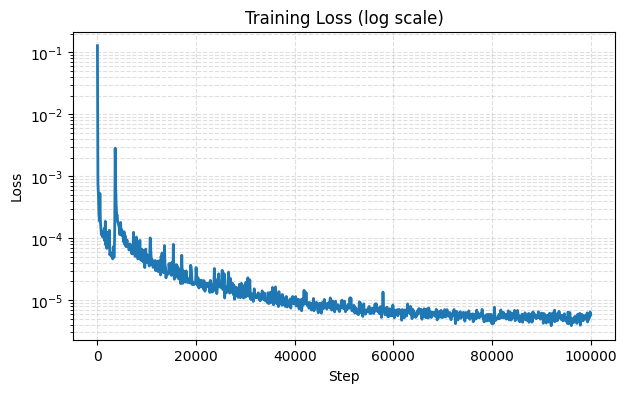

In [63]:
import re, pathlib, matplotlib.pyplot as plt

text = pathlib.Path(check_netdir, "train.log").read_text()
loss_pairs = [(int(s), float(v)) for s, v in re.findall(r"\[step:\s*(\d+)\]\s+loss:\s+([0-9.eE+-]+)", text)]

plt.figure(figsize=(7,4))
plt.plot([t for t,_ in loss_pairs], [v for _,v in loss_pairs], lw=2)
plt.yscale("log")
plt.title("Training Loss (log scale)")
plt.xlabel("Step"); plt.ylabel("Loss")
plt.grid(True, which="both", ls="--", alpha=0.4)
plt.show()


[Idx 0]  MSE=1.673e-08  RMSE=1.294e-04  RelL2(classic)=1.719e-02  RelL2(validator)=3.003e-02


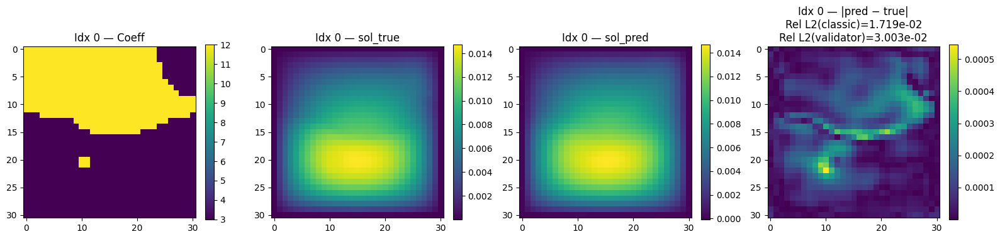

In [62]:
import numpy as np, torch, matplotlib.pyplot as plt
# 설정
idx = 0
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_graph = data_Darcy.model  # 학습된 Graph


# 1) 샘플/격자 크기 추정
total_pts = outvar_test['sol'].shape[0]
H = invar_test['coeff'].shape[-2]
W = invar_test['coeff'].shape[-1]
N_guess = invar_test['coeff'].shape[0] // (H * W)
if N_guess == 0:
    raise ValueError("Shape inference failed. Check input shapes.")
P_per_sample = total_pts // N_guess        # 포인트 수 = R*R
R = int(np.sqrt(P_per_sample))
s, e = idx * P_per_sample, (idx + 1) * P_per_sample


# 2) 예측
inv = {
    "coeff": torch.as_tensor(invar_test['coeff'][s:e], dtype=torch.float32, device=device),
    "x"    : torch.as_tensor(invar_test['x'][s:e],     dtype=torch.float32, device=device),
    "y"    : torch.as_tensor(invar_test['y'][s:e],     dtype=torch.float32, device=device),
}
model_graph.to(device).eval()
with torch.no_grad():
    out = model_graph(inv)["sol"]  # (P,1)

pred_2d  = out.view(R, R).detach().cpu().numpy()
ref_2d   = outvar_test['sol'][s:e].reshape(R, R)
coeff_2d = invar_test['coeff'][s, 0]

# 3) 지표
diff  = pred_2d - ref_2d
mse   = float(np.mean(diff**2))
rmse  = float(np.sqrt(mse))
rel_l2_classic   = float(np.linalg.norm(diff.ravel()) / (np.linalg.norm(ref_2d.ravel()) + 1e-12))
std_true         = float(np.std(ref_2d.ravel(), ddof=1)) if ref_2d.size > 1 else 0.0
rel_l2_validator = float(rmse / (std_true + 1e-12))

print(f"[Idx {idx}]  MSE={mse:.3e}  RMSE={rmse:.3e}  RelL2(classic)={rel_l2_classic:.3e}  RelL2(validator)={rel_l2_validator:.3e}")

# 4) 4분할 플롯: coeff / true / pred / |error|
plt.figure(figsize=(16,4))

plt.subplot(1,4,1)
plt.imshow(coeff_2d); plt.colorbar(fraction=0.046)
plt.title(f"Idx {idx} — Coeff", fontsize=12)

plt.subplot(1,4,2)
plt.imshow(ref_2d); plt.colorbar(fraction=0.046)
plt.title(f"Idx {idx} — sol_true", fontsize=12)

plt.subplot(1,4,3)
plt.imshow(pred_2d); plt.colorbar(fraction=0.046)
plt.title(f"Idx {idx} — sol_pred", fontsize=12)

plt.subplot(1,4,4)
plt.imshow(np.abs(diff)); plt.colorbar(fraction=0.046)
plt.title(
    f"Idx {idx} — |pred − true|\n"
    f"Rel L2(classic)={rel_l2_classic:.3e}\n"
    f"Rel L2(validator)={rel_l2_validator:.3e}",
    fontsize=12
)
plt.tight_layout()
plt.show()

# Anti-Derivative : Data Driven

## Problem Description — Anti-derivative (Data-informed DeepONet)

## 목표
1D 초기값 문제
$$
\frac{du}{dx} = a(x),\quad x\in[0,1],\qquad u(0)=0
$$
에 대해 반적분 연산자 $\mathcal{G}$를 **데이터 기반**으로 학습한다.  
$$
\mathcal{G}: a(\cdot)\ \mapsto\ u(x)=\int_{0}^{x} a(t)\,dt
$$

DeepONet 구조를 사용하므로 입력 함수 $a(x)$의 격자와 질의 좌표 $x$의 격자가 서로 달라도 추론이 가능하다.


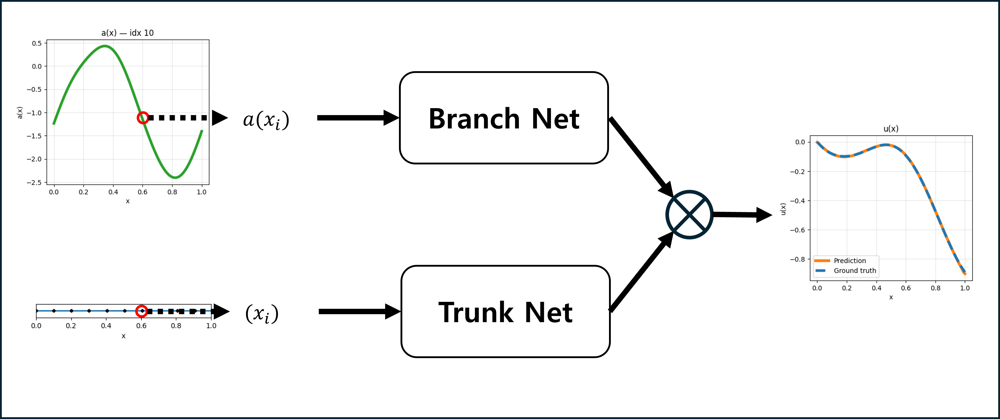

## 1. Load Hydra

In [73]:
from pathlib import Path
import sys
from hydra import compose, initialize_config_dir
from hydra.core.global_hydra import GlobalHydra
from omegaconf import OmegaConf
import physicsnemo.sym

# 노트북이 붙이는 -f 인자 제거
sys.argv = [sys.argv[0]]

CONF_DIR_Anti_d = Path(REPO) / "Anti_derivative_DeepONet" / "conf"
CONF_NAME_Anti_d = "config.yaml"
print("CONF_DIR exists:", CONF_DIR_Anti_d.exists())
print("YAML exists    :", (CONF_DIR_Anti_d/CONF_NAME_Anti_d).exists())

@physicsnemo.sym.main(
    config_path=str(CONF_DIR_Anti_d),
    config_name="config",
)
def _preview_config(cfg) -> None:
    print("=== Config successfully loaded ===")
    try:
        print(OmegaConf.to_yaml(cfg))
    except Exception:
        print(cfg)

try:
    _preview_config()
except SystemExit:
    # Hydra decorator가 sys.exit를 호출할 수 있어 잡아줌
    pass

# 노트북 반복 실행 시 Hydra 인스턴스 정리
if GlobalHydra.instance().is_initialized():
    GlobalHydra.instance().clear()

initialize_config_dir(config_dir=str(CONF_DIR_Anti_d))
cfg_Anti_d = compose(config_name="config")

TorchScript default is being turned off due to PyTorch version mismatch.


CONF_DIR exists: True
YAML exists    : True


Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/hydra/_internal/utils.py", line 220, in run_and_report
    return func()
           ^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/hydra/_internal/utils.py", line 356, in <lambda>
    lambda: Hydra.create_main_hydra2(
            ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/hydra/_internal/hydra.py", line 68, in create_main_hydra2
    GlobalHydra.instance().initialize(hydra)
  File "/usr/local/lib/python3.12/dist-packages/hydra/core/global_hydra.py", line 16, in initialize
    raise ValueError(
ValueError: GlobalHydra is already initialized, call GlobalHydra.instance().clear() if you want to re-initialize
/tmp/ipython-input-430789095.py:37: UserWarning: 
The version_base parameter is not specified.
Please specify a compatability version level, or None.
Will assume defaults for version 1.1
  initialize_config_dir(config_dir=str(CONF_DIR_Anti_d))


In [74]:
from pprint import pprint
def summarize_cfg(cfg):
    d = to_dict(cfg)
    return {
        "training": {
            "max_steps": pluck(d, "training", "max_steps"),
            "ntk"      : pluck(d, "training", "ntk"),
        },
        "branch": {
            "arch_type"    : pluck(d, "arch", "branch", "arch_type"),
            "activation_fn": pluck(d, "arch", "branch", "activation_fn"),
        },
        "trunk": {
            "arch_type"    : pluck(d, "arch", "trunk", "arch_type"),
            "activation_fn": pluck(d, "arch", "trunk", "activation_fn"),
        },
        "deeponet": {
            "arch_type"   : pluck(d, "arch", "deeponet", "arch_type"),
            "output_keys" : pluck(d, "arch", "deeponet", "output_keys"),
        },
        "loss": {
            "_target_" : pluck(d, "loss", "_target_"),
            "weights"  : pluck(d, "loss", "weights"),
        },
        "optimizer": {
            "_target_"    : pluck(d, "optimizer", "_target_"),
            "lr"          : pluck(d, "optimizer", "lr"),
            "betas"       : pluck(d, "optimizer", "betas"),
            "eps"         : pluck(d, "optimizer", "eps"),
            "weight_decay": pluck(d, "optimizer", "weight_decay"),
            "amsgrad"     : pluck(d, "optimizer", "amsgrad"),
        },
        "batch_size": {
            "train": pluck(d, "batch_size", "train"),
        },
    }

summary = summarize_cfg(cfg_Anti_d)
pprint(summary, width=100, sort_dicts=False)

# 출력/체크포인트 디렉토리 지정(없으면 생성)
from pathlib import Path
cfg_Anti_d.network_dir = f"{REPO}/Anti_derivative_DeepONet/data_outputs"
Path(cfg_Anti_d.network_dir).mkdir(parents=True, exist_ok=True)


{'training': {'max_steps': 10000, 'ntk': {'use_ntk': False, 'save_name': None, 'run_freq': 1000}},
 'branch': {'arch_type': 'fully_connected', 'activation_fn': 'silu'},
 'trunk': {'arch_type': 'fourier', 'activation_fn': 'silu'},
 'deeponet': {'arch_type': 'deeponet', 'output_keys': 'u'},
 'loss': {'_target_': 'physicsnemo.sym.loss.aggregator.Sum', 'weights': None},
 'optimizer': {'_target_': 'torch.optim.Adam',
               'lr': 0.001,
               'betas': [0.9, 0.999],
               'eps': 1e-08,
               'weight_decay': 0.0,
               'amsgrad': False},
 'batch_size': {'train': 10000}}


## 2. Load Datasets (train / test(valid))

### 데이터 구성
- **입력 $(a(x))$**: 길이 척도 $(l=0.2)$의 **가우시안 랜덤장(GRF)** 로부터 다수 샘플 생성.
- **타깃 $(u(x;a(x)))$**: 각 $a(x)$에 대해 수치 적분으로 $u(x)$ 생성.
- **학습 샘플화**: $((a, x)\mapsto u)$의 포인트 단위 지도 쌍으로 구성 (각 $(a,u)$에서 일부 $x$ 포인트만 사용해도 학습 가능).
- **분할**: train / val(test) 세트로 분리.

In [75]:
import numpy as np
from physicsnemo.sym.hydra import (
    to_absolute_path,
    PhysicsNeMoConfig,
)

train_path_Anti_d = "/content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/data/anti_derivative_train.npy"
test_path_Anti_d  = "/content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/data/anti_derivative_test.npy"

train_data = np.load(to_absolute_path(train_path_Anti_d), allow_pickle = True).item()
x_train = train_data["x_train"]
a_train = train_data["a_train"]
u_train = train_data["u_train"]

test_data = np.load(to_absolute_path(test_path_Anti_d), allow_pickle = True).item()
x_test = test_data["x_test"]
a_test = test_data["a_test"]
u_test = test_data["u_test"]



## 3. Build DeepONet & Domain

### 모델(DeepONet) 개요
- **Branch net**: 함수 $a(x)$ (고정 격자 샘플)를 입력 → 임베딩 $(\mathbf{b}\in\mathbb{R}^{128})$.
- **Trunk net**: 좌표 $x$ 를 입력 → 임베딩 $(\mathbf{t}(x)\in\mathbb{R}^{128})$.
- **DeepONet**: $(\hat{u}(x)=\langle \mathbf{b},\,\mathbf{t}(x)\rangle)$ 또는 (concat → MLP)로 최종 스칼라 출력.


In [76]:
from physicsnemo.sym.models.fully_connected import FullyConnectedArch
from physicsnemo.sym.models.fourier_net import FourierNetArch
from physicsnemo.sym.models.deeponet import DeepONetArch
from physicsnemo.sym.key import Key

trunk_net_Anti_d = FourierNetArch(
    input_keys=[Key("x")],
    output_keys=[Key("trunk", 128)],
)
branch_net_Anti_d = FullyConnectedArch(
    input_keys=[Key("a", 100)],
    output_keys=[Key("branch", 128)],
)
deeponet_Anti_d = DeepONetArch(
    output_keys=[Key("u")],
    branch_net=branch_net_Anti_d,
    trunk_net=trunk_net_Anti_d,
)

nodes_Anti_d = [deeponet_Anti_d.make_node("deepo")]

### 학습 제약(Constraint)
- **Pointwise 지도 학습**:  
  `DeepONetConstraint.from_numpy(nodes, invar={"a": a_train, "x": x_train}, outvar={"u": u_train}, batch_size=...)`
- **손실**: 기본 L2/MSE(pointwise). 필요 시 가중치(lambda) 부여 가능.

### 검증(Validator)
- **Grid 검증자** 사용
  - 입력: $(\{a, x\})$, 타깃: $(\{u\})$
  - 산출: 상대 $L^2$


In [81]:
from physicsnemo.sym.domain import Domain
from physicsnemo.sym.domain.constraint.continuous import DeepONetConstraint
from physicsnemo.sym.domain.validator.discrete import GridValidator
from physicsnemo.sym.dataset.discrete import DictGridDataset

domain = Domain()

data_Anti_d = DeepONetConstraint.from_numpy(
  nodes=nodes_Anti_d,
  invar={"a": a_train, "x": x_train},
  outvar={"u": u_train},
  batch_size=cfg_Anti_d.batch_size.train,
)
domain.add_constraint(data_Anti_d, "data")

# a_test.shape = (10000, 100) = (100, 100)이 100개 존재. => slicing을 통해 구분.
for k in range(10):
  invar_valid = {
      "a": a_test[k * 100 : (k + 1) * 100],
      "x": x_test[k * 100 : (k + 1) * 100],
  }
  outvar_valid = {"u": u_test[k * 100 : (k + 1) * 100]}
  dataset = DictGridDataset(invar_valid, outvar_valid)

  validator = GridValidator(nodes=nodes_Anti_d, dataset=dataset, plotter=None)
  domain.add_validator(validator, "validator_{}".format(k))

## 4. Logging to file for Loss function

In [82]:
import logging, pathlib
logger = logging.getLogger()
logger.handlers.clear()  # 중복 핸들러 방지

logfile = pathlib.Path(cfg_Anti_d.network_dir, "train.log")
fh = logging.FileHandler(logfile, mode="w")
sh = logging.StreamHandler()

logger.setLevel(logging.INFO)
logger.addHandler(sh)
logger.addHandler(fh)

print(f"Logging to {logfile.resolve()}")

Logging to /content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/data_outputs/train.log


## 5. Training

In [83]:
from physicsnemo.sym.solver import Solver
slv = Solver(cfg_Anti_d, domain)
slv.solve()

Installed PyTorch version 2.8.0+cu126 is not TorchScript supported in PhysicsNeMo. Version 2.1.0a0+4136153 is officially supported.
/usr/local/lib/python3.12/dist-packages/physicsnemo/sym/amp.py:219: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  super().__init__(*args, **kwargs)
attempting to restore from: /content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/data_outputs
optimizer checkpoint not found
model deepo.0.pth not found
[step:          0] record constraint batch time:  2.623e-01s
[step:          0] record validators time:  4.161e-02s
[step:          0] saved checkpoint to /content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/data_outputs
[step:          0] loss:  1.811e+03
Attempting cuda graph building, this may take a bit...
[step:        100] loss:  1.594e+01, time/iteration:  1.730e+02 ms
[step:        200] loss:  9.845e+00, time/iteration:  6.267e+01 ms


KeyboardInterrupt: 

## (이전에 학습 한 자료가 있을 경우) Parameter load

In [84]:
# 평가 모드(eval)
check_netdir = "/content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/pre_data_output"
check_netdir = os.path.abspath(check_netdir)

cfg_Anti_d.run_mode = "eval"   # 평가 모드
cfg_Anti_d.network_dir = check_netdir

slv = Solver(cfg_Anti_d, domain)
slv.solve()  # 내부에서 _eval() 실행: 모델 로드 + validator/inferencer/monitor 기록

# 재학습 모드(re-train)
# cfg_Anti_d.run_mode = "train"   # 평가 모드
# cfg_Anti_d.network_dir = check_netdir

# slv_again = Solver(cfg_Anti_d, domain)
# slv_again.solve()  # 내부에서 _eval() 실행: 모델 로드 + validator/inferencer/monitor 기록

Success loading model: /content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/pre_data_output/deepo.0.pth
[step:          0] record validators time:  3.655e-02s


## (참고) TensorBoard 확인

In [85]:
%load_ext tensorboard
%tensorboard --logdir "$slv_reload.network_dir"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## 6. Plots

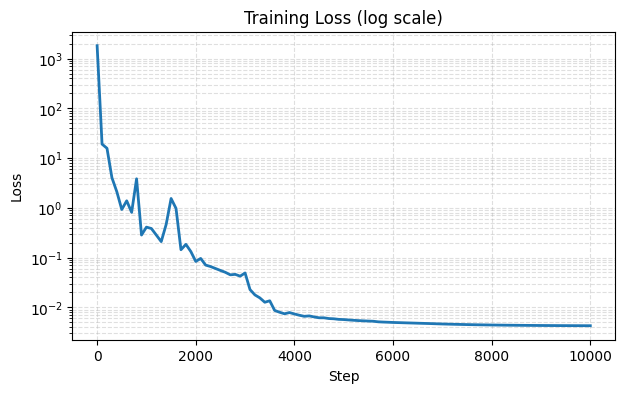

In [86]:
import re, pathlib, matplotlib.pyplot as plt

text = pathlib.Path(check_netdir, "train.log").read_text()
loss_pairs = [(int(s), float(v)) for s, v in re.findall(r"\[step:\s*(\d+)\]\s+loss:\s+([0-9.eE+-]+)", text)]

plt.figure(figsize=(7,4))
plt.plot([t for t,_ in loss_pairs], [v for _,v in loss_pairs], lw=2)
plt.yscale("log")
plt.title("Training Loss (log scale)")
plt.xlabel("Step"); plt.ylabel("Loss")
plt.grid(True, which="both", ls="--", alpha=0.4)
plt.show()


[func #10]  MSE=5.794e-06  RMSE=2.407e-03  RelL2=6.884e-03  Validator=9.096e-03


/tmp/ipython-input-2806244003.py:90: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


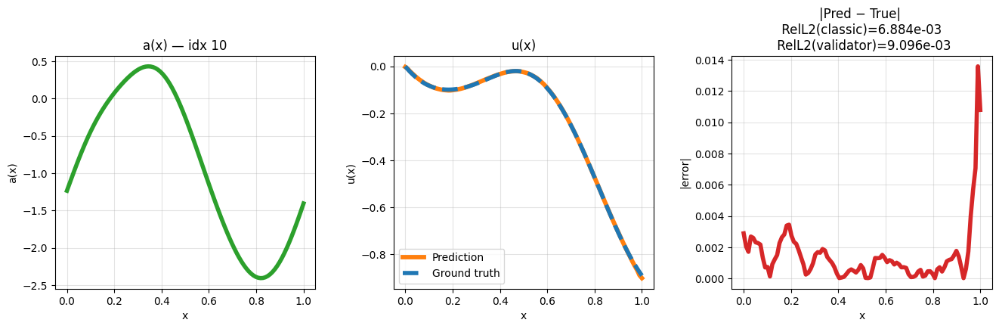

In [88]:
import numpy as np, torch, matplotlib.pyplot as plt

# ===== 사용자 설정 =====
idx = 10
graph_load = data_Anti_d.model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ===== 1) grid_len 추정 (동일 a가 연속된 구간 길이) =====
a_all = np.asarray(a_test)
if a_all.ndim == 1:
    a_all = a_all.reshape(-1, 1)
a0 = a_all[0]
diff = np.any(~np.isclose(a_all, a0), axis=1)
first_change = int(np.argmax(diff))
grid_len = first_change if first_change > 0 else int(len(a_all))

# ===== 2) i번째 곡선 슬라이스 =====
s, e = idx * grid_len, (idx + 1) * grid_len
if e > len(x_test):
    raise IndexError(f"i={idx}, grid_len={grid_len}가 전체 길이를 초과합니다.")

x_i     = np.asarray(x_test[s:e]).reshape(-1)
u_true  = np.asarray(u_test[s:e]).reshape(-1)

# ===== 3) 예측 =====
inv = {
    "a": torch.as_tensor(a_test[s:e]).float().to(device),
    "x": torch.as_tensor(x_test[s:e]).float().to(device),
}
graph_load.to(device).eval()
with torch.no_grad():
    u_pred = graph_load(inv)["u"].reshape(-1).detach().cpu().numpy()

# ===== 4) 지표 계산 (classic & validator) =====
eps  = 1e-12
err  = u_pred - u_true
mse  = float(np.mean(err**2))
rmse = float(np.sqrt(mse))
rel2 = float(np.linalg.norm(err) / (np.linalg.norm(u_true) + eps))
stdt = float(np.std(u_true, ddof=1)) if u_true.size > 1 else 0.0
vali = float(rmse / (stdt + eps))

print(f"[func #{idx}]  MSE={mse:.3e}  RMSE={rmse:.3e}  RelL2={rel2:.3e}  Validator={vali:.3e}")

# ===== 5) 플롯 (x 정렬 후 오버레이) =====
order   = np.argsort(x_i)
x_plot  = x_i[order]
u_true_d = u_true[order]
u_pred_d = u_pred[order]
err_abs  = np.abs(u_pred_d - u_true_d)

title = (
    f"1D Function — idx {idx}\n"
    f"Rel L2 (classic) = {rel2:.3e}   "
    f"Rel L2 (Validator) = {vali:.3e}"
)

if a_test.ndim == 2 and a_test.shape[0] >= (e) and a_test.shape[1] > 1:
    a_vec = np.asarray(a_test[s])
else:
    # 예외적 구조일 때는 s:e 구간의 첫 행을 사용 (필요시 맞게 수정)
    a_slice = np.asarray(a_test[s:e])
    a_vec = a_slice[0] if a_slice.ndim == 2 else a_slice.reshape(-1)

xa = np.linspace(0, 1, a_vec.shape[-1])  # a 벡터 정의축(0~1)로 간단히 가정

# 6-2) 플롯
fig, axes = plt.subplots(1, 3, figsize=(16, 4), gridspec_kw={"wspace": 0.3})

# (1) a(x)
axes[0].plot(xa, a_vec, lw=4.0, color="C2")
axes[0].set_title(f"a(x) — idx {idx}", fontsize=12)
axes[0].set_xlabel("x"); axes[0].set_ylabel("a(x)")
axes[0].grid(True, alpha=0.35)

# (2) u overlay
axes[1].plot(x_plot, u_pred_d, lw=4.2, label="Prediction", color="C1")
axes[1].plot(x_plot, u_true_d, lw=4.0, ls="--", label="Ground truth", color="C0")
axes[1].set_title("u(x)", fontsize=12)
axes[1].set_xlabel("x"); axes[1].set_ylabel("u(x)")
axes[1].grid(True, alpha=0.35); axes[1].legend()

# (3) |pred - true| + 지표 텍스트(제목 아래)
axes[2].plot(x_plot, err_abs, lw=4.0, color="tab:red")
axes[2].set_title(f"|Pred − True| \n RelL2(classic)={rel2:.3e} \n RelL2(validator)={vali:.3e}", fontsize=12)
axes[2].set_xlabel("x"); axes[2].set_ylabel("|error|")
axes[2].grid(True, alpha=0.35)


plt.tight_layout()
plt.show()



# Anti-Derivative : Physics-informed

## Problem Description — Anti-derivative (Data-informed DeepONet)

## 목표
1D 초기값 문제
$$
\frac{du}{dx} = a(x),\quad x\in[0,1],\qquad u(0)=0
$$
에서 정답($u(x)$) 라벨 없이, **물리식(잔차)만으로 반적분 연산자 $\mathcal{G}$를 학습한다.  
$$
\mathcal{G}: a(\cdot)\ \mapsto\ \mathcal{G}[a](x)=a(x)
$$
이를 (수치)적분을 하여 $$\hat{u}(x) = \int_{0}^{x} \mathcal{G}[a](t)dt$$ 예측한다.


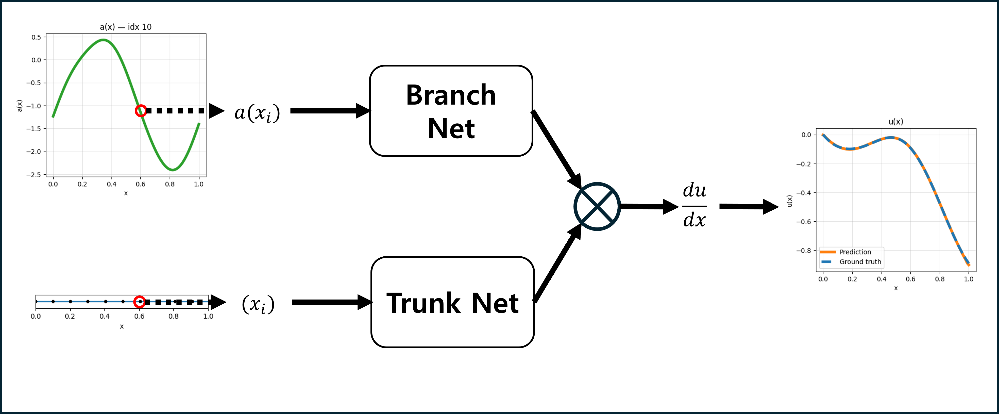

## 1. Load Hydra config safely

In [89]:
from pathlib import Path
import sys
from hydra import compose, initialize_config_dir
from hydra.core.global_hydra import GlobalHydra
from omegaconf import OmegaConf
import physicsnemo.sym

# 노트북이 붙이는 -f 인자 제거
sys.argv = [sys.argv[0]]

CONF_DIR_Anti_p = Path(REPO) / "Anti_derivative_DeepONet" / "conf"
CONF_NAME_Anti_p = "config.yaml"
print("CONF_DIR exists:", CONF_DIR_Anti_p.exists())
print("YAML exists    :", (CONF_DIR_Anti_p/CONF_NAME_Anti_p).exists())

@physicsnemo.sym.main(
    config_path=str(CONF_DIR_Anti_p),
    config_name="config",
)
def _preview_config(cfg) -> None:
    print("=== Config successfully loaded ===")
    try:
        print(OmegaConf.to_yaml(cfg))
    except Exception:
        print(cfg)

try:
    _preview_config()
except SystemExit:
    # Hydra decorator가 sys.exit를 호출할 수 있어 잡아줌
    pass

# 노트북 반복 실행 시 Hydra 인스턴스 정리
if GlobalHydra.instance().is_initialized():
    GlobalHydra.instance().clear()

initialize_config_dir(config_dir=str(CONF_DIR_Anti_p))
cfg_Anti_p = compose(config_name="config")

TorchScript default is being turned off due to PyTorch version mismatch.


CONF_DIR exists: True
YAML exists    : True


Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/hydra/_internal/utils.py", line 220, in run_and_report
    return func()
           ^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/hydra/_internal/utils.py", line 356, in <lambda>
    lambda: Hydra.create_main_hydra2(
            ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/hydra/_internal/hydra.py", line 68, in create_main_hydra2
    GlobalHydra.instance().initialize(hydra)
  File "/usr/local/lib/python3.12/dist-packages/hydra/core/global_hydra.py", line 16, in initialize
    raise ValueError(
ValueError: GlobalHydra is already initialized, call GlobalHydra.instance().clear() if you want to re-initialize
/tmp/ipython-input-963278907.py:37: UserWarning: 
The version_base parameter is not specified.
Please specify a compatability version level, or None.
Will assume defaults for version 1.1
  initialize_config_dir(config_dir=str(CONF_DIR_Anti_p))


In [90]:
from pathlib import Path
cfg_Anti_p.network_dir = f"{REPO}/Anti_derivative_DeepONet/phys_outputs"
Path(cfg_Anti_p.network_dir).mkdir(parents=True, exist_ok=True)


## Load Data

### 데이터 구성
- **입력 $a(x)$**: GRF 등으로 생성하거나 주어진 샘플을 사용.
- **좌표 샘플 $x$**: $([0,1])$에서 내부점 $(x_\mathrm{int})$와 경계점 $(x=0)$을 샘플.
- **타깃**: 없음(물리식으로만 지도).
  - IC : 경계점의 정보 이용
  - residual : predict 값이 $\hat{u}$일 때, $\left|\frac{d \hat{u}}{d x} - a(x)\right|$가 0이 되도록 학습

** 해당 데이터는 용량이 커서 github에 없는 관계로 다운 받아야 함(대략 397mb)

In [91]:
!wget --content-disposition 'https://api.ngc.nvidia.com/v2/resources/org/nvidia/team/physicsnemo/physicsnemo_sym_examples_supplemental_materials/0.0.1/files?redirect=true&path=examples/anti_derivative/data/anti_derivative.npy' --output-document '/content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/data/anti_derivative.npy'

--2025-11-08 13:24:08--  https://api.ngc.nvidia.com/v2/resources/org/nvidia/team/physicsnemo/physicsnemo_sym_examples_supplemental_materials/0.0.1/files?redirect=true&path=examples/anti_derivative/data/anti_derivative.npy
Resolving api.ngc.nvidia.com (api.ngc.nvidia.com)... 35.163.44.179, 52.41.125.236
Connecting to api.ngc.nvidia.com (api.ngc.nvidia.com)|35.163.44.179|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://xfiles.ngc.nvidia.com/org/nvidia/team/physicsnemo/recipes/physicsnemo_sym_examples_supplemental_materials/versions/0.0.1/files/examples/anti_derivative/data/anti_derivative.npy?versionId=KkKMt4VqYSANlA_SnKYvvA5aQm_92S8g&Expires=1762694649&Signature=iqSmnn6S67-4Y4Kjah7K4~eUk5SNr4V~N1q43165WZ0aM7mx31YrekKvPjit96wRfqe2x7PFJqnrWh-yWACf0R61mD3xtOzdlk4RRrk9761yihLY2kqPoUmwx794J7hjLTkZHZISpzJY3U3VZHhp5y7vFNGqst9JIO2fBiYjJNIN8i5bAzhTg2Q0~s1K4CgGLvG-HaEPOBwqTe7CX68zZttAs64aAyxUmzMZUHrdyrIf18l1fb20vX91sRlpOXfToltNttFIxn1X6R4Uxr2RxYjnlq2pjN5ApmCU

In [92]:
import warnings

file_path = "/content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/data/anti_derivative.npy"
if not os.path.exists(to_absolute_path(file_path)):
    warnings.warn(
        f"Directory {file_path} does not exist. Cannot continue. Please download the additional files from NGC https://catalog.ngc.nvidia.com/orgs/nvidia/teams/physicsnemo/resources/physicsnemo_sym_examples_supplemental_materials"
    )
    sys.exit()

data = np.load(to_absolute_path(file_path), allow_pickle=True).item()
x_train = data["x_train"]
a_train = data["a_train"]
u_train = data["u_train"]

x_r_train = data["x_r_train"]
a_r_train = data["a_r_train"]
u_r_train = data["u_r_train"]

# load test data
x_test = data["x_test"]
a_test = data["a_test"]
u_test = data["u_test"]

## 4. Build DeepONet & Domain

### 모델(DeepONet) 개요
- **Branch**: 함수 $a(x)$를 입력 → 임베딩 $(\mathbf{b}\in\mathbb{R}^{128})$
- **Trunk**:좌표 $x$를 입력 → 임베딩 $(\mathbf{t}(x)\in\mathbb{R}^{128})$
- **DeepONet**: $(\hat{u}(x)=\langle \mathbf{b},\mathbf{t}(x)\rangle)$로 최종 스칼라 출력



In [93]:
from physicsnemo.sym.models.fully_connected import FullyConnectedArch
from physicsnemo.sym.models.fourier_net import FourierNetArch
from physicsnemo.sym.models.deeponet import DeepONetArch
from physicsnemo.sym.key import Key

trunk_net_Anti_p = FourierNetArch(
    input_keys=[Key("x")],
    output_keys=[Key("trunk", 128)],
)
branch_net_Anti_p = FullyConnectedArch(
    input_keys=[Key("a", 100)],
    output_keys=[Key("branch", 128)],
)
deeponet_Anti_p = DeepONetArch(
    output_keys=[Key("u")],
    branch_net=branch_net_Anti_p,
    trunk_net=trunk_net_Anti_p,
)

nodes_Anti_p = [deeponet_Anti_p.make_node("deepo")]



### 학습 제약(Physics-informed Constraint)
- **잔차 손실(내부)**:  
  $$
  \mathcal{L}_\mathrm{res}=\big\| \partial_x \hat{u}(x)-a(x)\big\|_2^2
  $$
- **경계 손실**:  
  $$
  \mathcal{L}_\mathrm{bc}=\big\|\hat{u}(0)-0\big\|_2^2
  $$
- **총손실**: $$\mathcal{L}=\lambda_\mathrm{res}\mathcal{L}_\mathrm{res}+\lambda_\mathrm{bc}\mathcal{L}_\mathrm{bc}$$

> 구현 시 `DeepONet` 출력 $(\hat{u})$에 대해 **자동미분(AutoDifferentiation)**으로 $(\partial_x\hat{u})$를 계산.


In [94]:
domain = Domain()

# add constraints to domain
IC = DeepONetConstraint.from_numpy(
  nodes=nodes_Anti_p,
  invar={"a": a_train, "x": np.zeros_like(x_train)},
  outvar={"u": np.zeros_like(u_train)},
  batch_size=cfg_Anti_p.batch_size.train,
)
domain.add_constraint(IC, "IC")
# [constraint1]

# [constraint2]
interior = DeepONetConstraint.from_numpy(
  nodes=nodes_Anti_p,
  invar={"a": a_r_train, "x": x_r_train},
  outvar={"u__x": u_r_train},
  batch_size=cfg_Anti_p.batch_size.train,
)
domain.add_constraint(interior, "Residual")

# [validator]

for k in range(10):
  invar_valid = {
      "a": a_test[k * 100 : (k + 1) * 100],
      "x": x_test[k * 100 : (k + 1) * 100],
  }
  outvar_valid = {"u": u_test[k * 100 : (k + 1) * 100]}
  dataset = DictGridDataset(invar_valid, outvar_valid)

  validator = GridValidator(nodes=nodes_Anti_p, dataset=dataset, plotter=None)
  domain.add_validator(validator, "validator_{}".format(k))

# Inferencer


## 4. Logging to file for Loss function

In [95]:
import logging, pathlib
logger = logging.getLogger()
logger.handlers.clear()  # 중복 핸들러 방지

logfile = pathlib.Path(cfg_Anti_p.network_dir, "train.log")
fh = logging.FileHandler(logfile, mode="w")
sh = logging.StreamHandler()

logger.setLevel(logging.INFO)
logger.addHandler(sh)
logger.addHandler(fh)

print(f"Logging to {logfile.resolve()}")

Logging to /content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/phys_outputs/train.log


## 5. Training

In [96]:
from physicsnemo.sym.solver import Solver
slv = Solver(cfg_Anti_p, domain)
slv.solve()

Installed PyTorch version 2.8.0+cu126 is not TorchScript supported in PhysicsNeMo. Version 2.1.0a0+4136153 is officially supported.
/usr/local/lib/python3.12/dist-packages/physicsnemo/sym/amp.py:219: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  super().__init__(*args, **kwargs)
attempting to restore from: /content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/phys_outputs
optimizer checkpoint not found
model deepo.0.pth not found
/usr/local/lib/python3.12/dist-packages/physicsnemo/sym/eq/derivatives.py:119: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=False):
[step:          0] record constraint batch time:  5.211e-01s
[step:          0] record validators time:  4.109e-02s
[step:          0] saved checkpoint to /content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/phys_outputs
[step:    

KeyboardInterrupt: 

## (이전에 학습 한 자료가 있을 경우) Parameter load

In [121]:
# 평가 모드(eval)
check_netdir = "/content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/pre_phys_output"
check_netdir = os.path.abspath(check_netdir)


cfg_Anti_p.run_mode = "eval"   # 평가 모드
cfg_Anti_p.network_dir = check_netdir

slv = Solver(cfg_Anti_p, domain)
slv.solve()  # 내부에서 _eval() 실행: 모델 로드 + validator/inferencer/monitor 기록

# 재학습 모드(re-train)
# cfg_Anti_p.run_mode = "train"   # 평가 모드
# cfg_Anti_p.network_dir = check_netdir

# slv_again = Solver(cfg_Anti_p, domain)
# slv_again.solve()  # 내부에서 _eval() 실행: 모델 로드 + validator/inferencer/monitor 기록

Success loading model: /content/PhysicsNemo_DeepONet/Anti_derivative_DeepONet/pre_phys_output/deepo.0.pth
[step:          0] record validators time:  3.711e-02s


In [98]:
%load_ext tensorboard
%tensorboard --logdir "$slv_reload.network_dir"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## 6. Plots

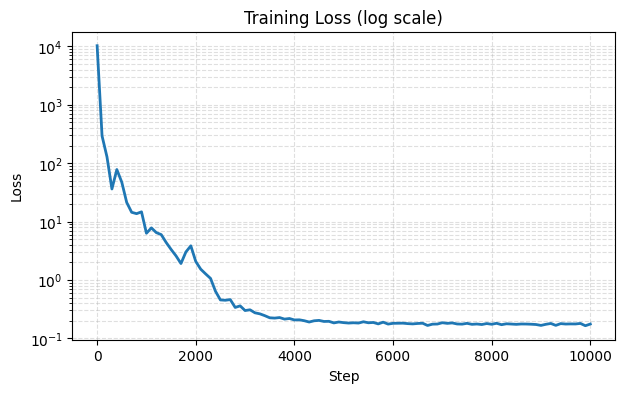

In [99]:
import re, pathlib, matplotlib.pyplot as plt

text = pathlib.Path(check_netdir, "train.log").read_text()
loss_pairs = [(int(s), float(v)) for s, v in re.findall(r"\[step:\s*(\d+)\]\s+loss:\s+([0-9.eE+-]+)", text)]

plt.figure(figsize=(7,4))
plt.plot([t for t,_ in loss_pairs], [v for _,v in loss_pairs], lw=2)
plt.yscale("log")
plt.title("Training Loss (log scale)")
plt.xlabel("Step"); plt.ylabel("Loss")
plt.grid(True, which="both", ls="--", alpha=0.4)
plt.show()


[func #8]  MSE=5.943e-08  RMSE=2.438e-04  RelL2=3.275e-04  Validator=5.147e-04


/tmp/ipython-input-3445681114.py:117: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Figure saved to: anti_derivative_idx008.png


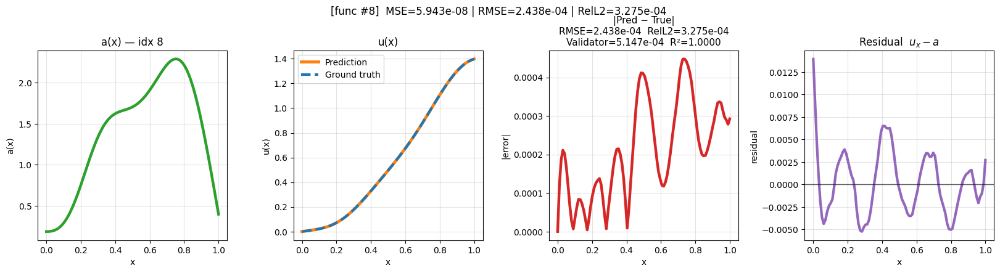

In [123]:
import numpy as np, torch, matplotlib.pyplot as plt

# 준비: 인덱스/디바이스
# 아래와 같이 바로 graph를 사용 할 수 없고
# slv.saveable_models = slv.get_saveable_models()
# slv.step = slv.load_step()
# slv.load_model()

graph_load = interior.model.to(slv.device).eval()
idx = 8
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 1) grid_len 추정 (동일 a가 연속된 구간 길이)
a_all = np.asarray(a_test)
if a_all.ndim == 1: a_all = a_all.reshape(-1, 1)
a0 = a_all[0]
diff = np.any(~np.isclose(a_all, a0), axis=1)
first_change = int(np.argmax(diff))
grid_len = first_change if first_change > 0 else int(len(a_all))

# 2) i번째 곡선 슬라이스
s, e = idx * grid_len, (idx + 1) * grid_len
x_i = np.asarray(x_test[s:e]).reshape(-1)
u_true = np.asarray(u_test[s:e]).reshape(-1)

# 3) 예측 - du/dx
inv = {
    "a": torch.as_tensor(a_test[s:e], dtype=torch.float32, device=device),
    "x": torch.as_tensor(x_test[s:e], dtype=torch.float32, device=device).requires_grad_(True),
}
graph_load.to(device).eval()
# 중요 : 학습한 것은 du/dx => Key는 "u__x"
u_x_pred = graph_load(inv)["u__x"].reshape(-1).detach().cpu().numpy()


order   = np.argsort(x_i)
x_plot  = x_i[order]
u_x_p   = u_x_pred[order]
u_true_p= u_true[order]

# 3-2) 누적 사다리꼴 적분으로 u(x) 재구성
# u(0)=0 경계 가정: integration constant C=0
def cumtrapz_same_len(y, x):
    y = np.asarray(y); x = np.asarray(x)
    dx = np.diff(x)
    area = 0.5 * (y[1:] + y[:-1]) * dx
    u = np.empty_like(y)
    u[0] = 0.0
    u[1:] = np.cumsum(area)
    return u
u_pred_p = cumtrapz_same_len(u_x_p, x_plot)
err_abs  = np.abs(u_pred_p - u_true_p)

# 4) 지표 계산 (classic & validator)
eps  = 1e-12
err  = u_pred_p - u_true_p
mse  = float(np.mean(err**2))
rmse = float(np.sqrt(mse))
rel2 = float(np.linalg.norm(err) / (np.linalg.norm(u_true_p) + eps))
stdt = float(np.std(u_true_p, ddof=1)) if u_true_p.size > 1 else 0.0
vali = float(rmse / (stdt + eps))
print(f"[func #{idx}]  MSE={mse:.3e}  RMSE={rmse:.3e}  RelL2={rel2:.3e}  Validator={vali:.3e}")


# a(x) 벡터 선택
if a_test.ndim == 2 and a_test.shape[0] >= (e) and a_test.shape[1] > 1:
    a_vec = np.asarray(a_test[s])  # (La,)
else:
    a_slice = np.asarray(a_test[s:e])
    a_vec = a_slice[0] if a_slice.ndim == 2 else a_slice.reshape(-1)
xa = np.linspace(0, 1, a_vec.shape[-1])  # a 벡터 정의축(0~1) 가정

# === 추가: 물리 잔차 시각화용 a 보간 & u_pred 미분 ===
a_on_x = np.interp(x_plot, xa, a_vec)                 # a(x_plot)
du_dx  = np.gradient(u_pred_p, x_plot, edge_order=2)  # 수치 미분
resid  = du_dx - a_on_x                                # 물리 잔차 u_x - a

# 6) 플롯
fig, axes = plt.subplots(1, 4, figsize=(20, 4), gridspec_kw={"wspace": 0.35})

# (1) a(x)
axes[0].plot(xa, a_vec, lw=3.2, color="C2")
axes[0].set_title(f"a(x) — idx {idx}", fontsize=12)
axes[0].set_xlabel("x"); axes[0].set_ylabel("a(x)")
axes[0].grid(True, alpha=0.35)

# (2) u overlay
axes[1].plot(x_plot, u_pred_p, lw=3.5, label="Prediction", color="C1")
axes[1].plot(x_plot, u_true_p, lw=3.0, ls="--", label="Ground truth", color="C0")
axes[1].set_title("u(x)", fontsize=12)
axes[1].set_xlabel("x"); axes[1].set_ylabel("u(x)")
axes[1].grid(True, alpha=0.35); axes[1].legend()

# (3) |pred - true| + 지표 텍스트
axes[2].plot(x_plot, err_abs, lw=3.2, color="tab:red")
axes[2].set_title(
    "|Pred − True|\n"
    f"RMSE={rmse:.3e}  RelL2={rel2:.3e}\n"
    f"Validator={vali:.3e}  R²={r2:.4f}",
    fontsize=11
)
axes[2].set_xlabel("x"); axes[2].set_ylabel("|error|")
axes[2].grid(True, alpha=0.35)

# (4) Physics-informed 잔차 u_x - a
axes[3].plot(x_plot, resid, lw=3.0, color="tab:purple")
axes[3].axhline(0.0, color="k", lw=1.0, alpha=0.6)
axes[3].set_title(r"Residual  $u_x - a$", fontsize=12)
axes[3].set_xlabel("x"); axes[3].set_ylabel("residual")
axes[3].grid(True, alpha=0.35)

# 상단 요약 제목 & 저장
fig.suptitle(
    f"[func #{idx}]  MSE={mse:.3e} | RMSE={rmse:.3e} | RelL2={rel2:.3e} ",
    fontsize=12, y=1.06
)
plt.tight_layout()

# === 추가: 저장 경로 (원하면 수정) ===
save_path = f"anti_derivative_idx{idx:03d}.png"
plt.savefig(save_path, dpi=180, bbox_inches="tight")
print(f"Figure saved to: {save_path}")

plt.show()
